# <h1 align="center">COSC2753 - Machine Learning</h1>

<h2 align="center">Group Machine Learning Project</h2>

---

### 👥 Group Members:
- Ngo Van Tai (S3974892)  
- Huynh Thai Duong (S)
- Huynh Tan Phat (S)
- Duong Minh Tri (S)

---


# CONVENTIONAL RULE

- Tất cả tên biến đều là snake case (variable_one)
- Tất cả function đều phải có docstring (có thể nhờ GPT rồi parapharse lại)
- Tất cả import library thì phải được đặt ở đầu file với comment rõ ràng vào cái phần của nó (ở chỗ import neccessary librariess)
- Hàm nào lặp lại quá nhiều lần thì phải define helper function (cùng với docstring) of course

# TABLE OF CONTENT

# IMPORT NECESSARY LIBRARIES

In [ ]:
# Data manipulation libraries
import pandas as pd
import numpy as np
import random
import cv2
import os
from tqdm import tqdm
from collections import defaultdict
import imagehash
from PIL import Image

# Data visualization libraries
import matplotlib.pyplot as plt
import seaborn as sns

# Image Visualization
import matplotlib.image as mpimg

# Data preprocessing
from sklearn.model_selection import train_test_split

## 1) Define Some Helper Functions

In [21]:
def print_header(content, padding=10, width=None, tabs=False):
    """
    Prints a header wrapped inside a box.

    Parameters:
    - content: Text to display as header (automatically uppercase)
    - padding: Spaces on each side of the content inside the box
    - width: Optional fixed width for the entire box. If None, adjusts to content size.
    - tabs: If true, adds the spacing `\t`to center of the box
    """
    content = content.upper()
    inner_width = len(content) + (padding * 2)
    box_width = width if width and width > inner_width else inner_width

    top_bottom = "+" + "-" * (box_width + 2) + "+"
    padded_content = "| " + content.center(box_width) + " |"
    prefix = "\t" * 3 if tabs else ""

    print(f"{prefix}{top_bottom}")
    print(f"{prefix}{padded_content}")
    print(f"{prefix}{top_bottom}")

In [187]:
def visualize_images(df, num_images=5, title=None, figsize=(15, 3)):
    """
    Visualize images from dataset

    Parameters:
    - df: DataFrame metadata
    - num_images: Number of images to display
    - title: Optional title for the entire figure
    - figsize: Size of the figure as (width, height) tuple
    """

    # Get image paths from the DataFrame
    image_paths = df["image_path"].tolist()
    num_images = len(image_paths)

    fig, axes = plt.subplots(1, num_images, figsize=figsize, facecolor="white")

    # Handle case of a single image
    if num_images == 1:
        axes = [axes]

    for idx, (_, row) in enumerate(df.iterrows()):
        file_path = row["image_path"]

        # Build title based on metadata
        title_parts = [f"ID: {row['image_id']}"]
        for col in row.index:
            if col not in ["image_id", "image_path"]:
                title_parts.append(f"{col}: {row[col]}")
        img_title = "\n".join(title_parts)

        try:
            img = mpimg.imread(file_path)
            axes[idx].imshow(img)
            axes[idx].axis("off")
            axes[idx].set_title(img_title, fontsize=9)
        except FileNotFoundError:
            print(f"Image not found: {file_path}")
            axes[idx].text(0.5, 0.5, "Image not found", ha="center", va="center")
            axes[idx].axis("off")

    # Add overall title if availabel
    if title:
        plt.suptitle(title, fontsize=14, y=1.01)
        plt.subplots_adjust(top=0.85)

    plt.tight_layout()
    plt.show()

# II. LOAD DATASET

## 1. Loading Dataset

In [188]:
original_df = pd.read_csv('./inputs/meta_train.csv')

# III. EXPLORATORY DATA ANALYSIS (EDA)

## 1) Dataset Overview

We can see that there are 4 columns inside the dataset:

| Column Name | Description |
|-------------|-------------|
| `image_id`  | Unique identifier for each image, matching the file names (.jpg) in the `train_images` directory |
| `label`     | The category of paddy disease. There are ten classes, including one for healthy (normal) plant |
| `variety`   | The paddy variety name |
| `age`       | The age of the paddy in days |

In [189]:
print_header('Dataset Overview')
original_df

+--------------------------------------+
|           DATASET OVERVIEW           |
+--------------------------------------+


,image_id,label,variety,age
0,100330.jpg,bacterial_leaf_blight,ADT45,45
1,100365.jpg,bacterial_leaf_blight,ADT45,45
2,100382.jpg,bacterial_leaf_blight,ADT45,45
3,100632.jpg,bacterial_leaf_blight,ADT45,45
4,101918.jpg,bacterial_leaf_blight,ADT45,45
...,...,...,...,...
10402,107607.jpg,tungro,Zonal,55
10403,107811.jpg,tungro,Zonal,55
10404,108547.jpg,tungro,Zonal,55
10405,110245.jpg,tungro,Zonal,55


## 2) Add `image_path` column

In the given dataset, the image path for the dataset is the combination of `label` and `image_id`. To simplify the development process, we created the `image_path` column for the dataset so it is easier to extract the image path.

In [190]:
train_img_dir = "./inputs/train_images"

# Copy original dataframe
df = original_df.copy()

df["image_path"] = df.apply(
    lambda row: os.path.join(train_img_dir, row["label"], row["image_id"]), axis=1
)

In [191]:
print_header("Dataset Overview After adding `image_path` column")
df['image_path']

+-----------------------------------------------------------------------+
|           DATASET OVERVIEW AFTER ADDING `IMAGE_PATH` COLUMN           |
+-----------------------------------------------------------------------+


0        ./inputs/train_images/bacterial_leaf_blight/10...
1        ./inputs/train_images/bacterial_leaf_blight/10...
2        ./inputs/train_images/bacterial_leaf_blight/10...
3        ./inputs/train_images/bacterial_leaf_blight/10...
4        ./inputs/train_images/bacterial_leaf_blight/10...
                               ...                        
10402              ./inputs/train_images/tungro/107607.jpg
10403              ./inputs/train_images/tungro/107811.jpg
10404              ./inputs/train_images/tungro/108547.jpg
10405              ./inputs/train_images/tungro/110245.jpg
10406              ./inputs/train_images/tungro/110381.jpg
Name: image_path, Length: 10407, dtype: object

## 2) Data Shape

In the initial observation, the given dataset contains over 10,000 rows, and five different column.

In [192]:
print_header("Data Shape")

print("Number of Rows: ", df.shape[0])
print("Number of Columns: ", df.shape[1])

+--------------------------------+
|           DATA SHAPE           |
+--------------------------------+
Number of Rows:  10407
Number of Columns:  5


## 3) Duplicated & Null Data

There is no duplicated or null data appearing in the given dataset. However, we need to compute image hashes to identify any duplicate images.

In [193]:
print_header('Missing Data')
df.isnull().sum()

+----------------------------------+
|           MISSING DATA           |
+----------------------------------+


image_id      0
label         0
variety       0
age           0
image_path    0
dtype: int64

In [194]:
print_header('Duplicated Data')
df.duplicated().sum()

+-------------------------------------+
|           DUPLICATED DATA           |
+-------------------------------------+


0

### Compute Image Hash

To identify duplicate images in the dataset, we used the `imagehash` library, especially the [`phash`](https://johannesbuchner.github.io/imagehash/art3.html) (perceptual hash) function. This function generates a hash value for each image, allowing us to detect duplicates.

After scanning through the dataset, we identified 180 duplicate sets, where each set contains at least two visually identical images. 

These duplicates must be handled properly, as they will cause bias during the training process. In this project, with the large original dataset, we will remove all duplicate images and keep only the first image from each duplicate set.

In [ ]:
print_header("Detecting Duplicate Images")

# Choose `phash` for image hashing
hash_fn = imagehash.phash

# Store hash, list of file paths
hash_dict = defaultdict(list)

for idx, row in tqdm(df.iterrows(), total=len(df), desc="Processing images"):
    img_path = row["image_path"]

    if not os.path.exists(img_path):
        print(f"[ERROR] {img_path} does not exist.")
        continue

    try:
        img = Image.open(img_path).convert("RGB")

        # Calculate hash and convert to string
        img_hash = str(hash_fn(img))
        hash_dict[img_hash].append(img_path)

    except Exception as e:
        print(f"[ERROR] {img_path}: {e}")


# Find duplicates
duplicate_sets = {h: paths for h, paths in hash_dict.items() if len(paths) > 1}

print_header("Duplicated data")
print(f"\nFound {len(duplicate_sets)} sets of duplicate images.")

+------------------------------------------------+
|           DETECTING DUPLICATE IMAGES           |
+------------------------------------------------+


Processing images: 100%|██████████| 10407/10407 [00:43<00:00, 237.62it/s]

+-------------------------------------+
|           DUPLICATED DATA           |
+-------------------------------------+

Found 180 sets of duplicate images.


+--------------------------------------------------------------+
|           DUPLICATE SET #1 (HASH=9C99E36458A7A978)           |
+--------------------------------------------------------------+


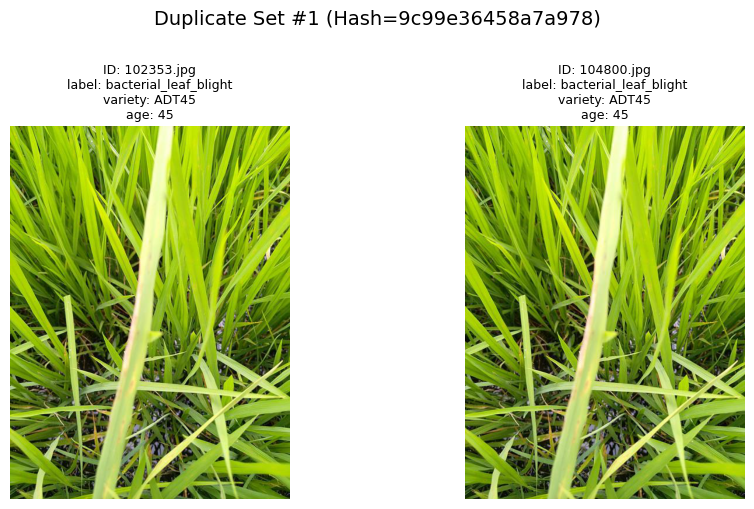

+--------------------------------------------------------------+
|           DUPLICATE SET #2 (HASH=FB9BA048DA1FE184)           |
+--------------------------------------------------------------+


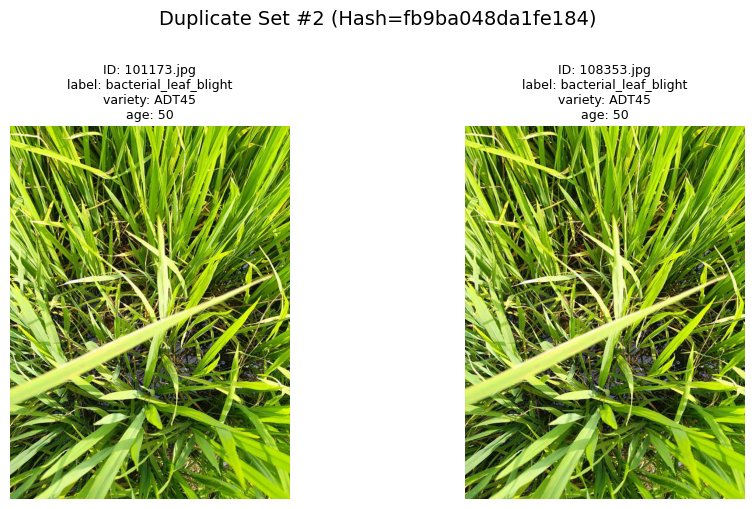

+--------------------------------------------------------------+
|           DUPLICATE SET #3 (HASH=F2CC1DE74118B2E3)           |
+--------------------------------------------------------------+


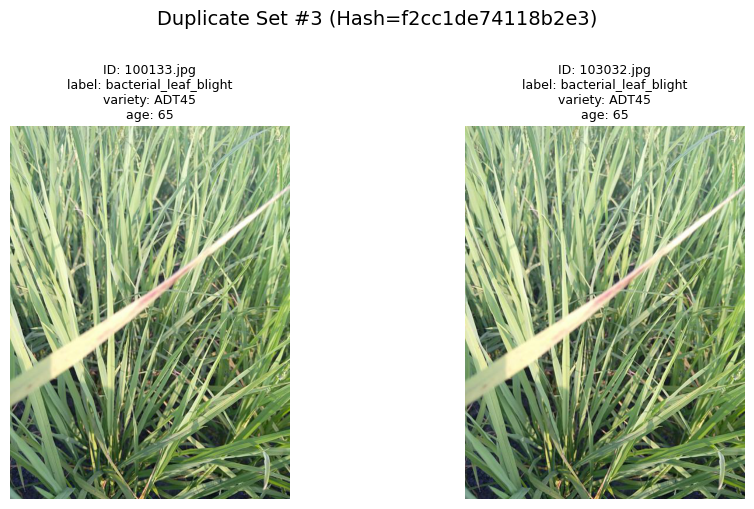

+--------------------------------------------------------------+
|           DUPLICATE SET #4 (HASH=CCA756B13B88E296)           |
+--------------------------------------------------------------+


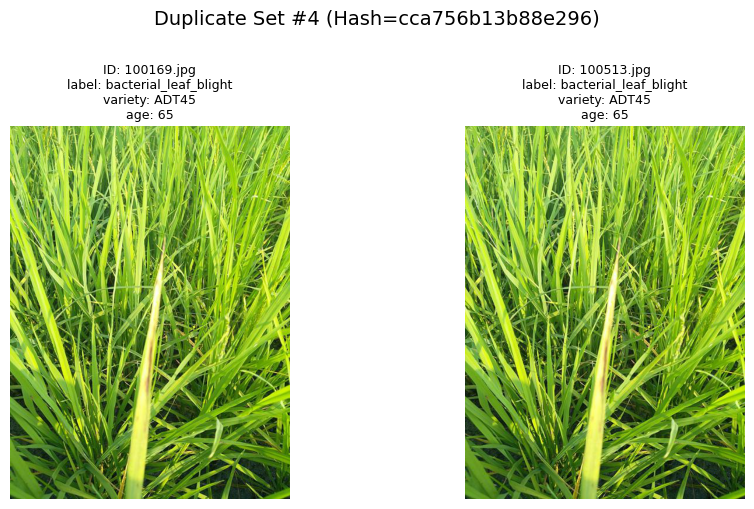

+--------------------------------------------------------------+
|           DUPLICATE SET #5 (HASH=E9B35FA043BE5881)           |
+--------------------------------------------------------------+


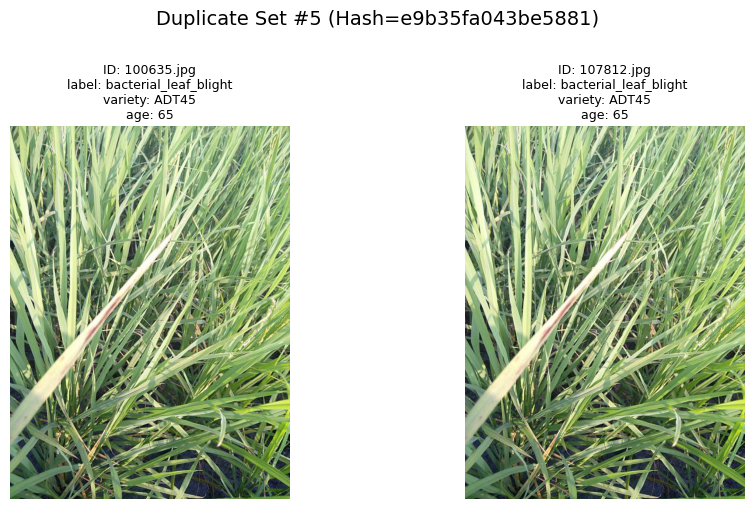

In [196]:
# Loop through first 5 duplicated set
for i, (h, paths) in enumerate(duplicate_sets.items()):
    if i >= 5:
        break

    title = f"Duplicate Set #{i+1} (Hash={h})"
    print_header(title)

    # Create df with duplicate images
    image_ids = [os.path.basename(path) for path in paths]

    duplicate_df = df[df["image_id"].isin(image_ids)].copy()

    title = f"Duplicate Set #{i+1} (Hash={h})"
    visualize_images(
        duplicate_df,
        num_images=len(duplicate_df),
        title=title,
        figsize=(5 * len(paths), 5),
    )

In [197]:
def remove_duplicated_images(
    df, duplicate_sets, output_path="./inputs/meta_train_clean.csv"
):
    """
    Removes duplicated images from the original dataset

    Parameters:
    - df: Dataframe of metadata
    - duplicated_sets: Dictionary mapping hashes to lists of duplicated images path
    - output_path: The path for output csv file
    """

    # copy the original df
    df_clean = df.copy()

    images_to_remove = []
    kept_images = []

    print_header("Duplicate Removal Process")

    for hash_val, image_paths in duplicate_sets.items():
        # keep the first image
        keep_path = image_paths[0]
        keep_filename = os.path.basename(keep_path)

        # Keep track of the kept images
        kept_images.append(
            {
                "hash": hash_val,
                "kept_image": keep_filename,
                "duplicate_count": len(image_paths) - 1,
            }
        )

        # Add the rest of the duplicate images to the removal list
        for remove_path in image_paths[1:]:
            remove_filename = os.path.basename(remove_path)
            images_to_remove.append(remove_filename)

    print(f"Total duplicate sets found: {len(duplicate_sets)}")
    print(f"Total images being removed: {len(images_to_remove)}")

    # Filter out the removed images from the DataFrame
    df_clean = df_clean[~df_clean["image_id"].isin(images_to_remove)]

    # Save the cleaned DataFrame
    df_clean.to_csv(output_path, index=False)

    print(f"\nRemoved {len(df) - len(df_clean)} duplicate entries from CSV")
    print(f"Updated CSV saved to: {output_path}")

In [198]:
remove_duplicated_images(df,duplicate_sets)

+-----------------------------------------------+
|           DUPLICATE REMOVAL PROCESS           |
+-----------------------------------------------+
Total duplicate sets found: 180
Total images being removed: 199

Removed 199 duplicate entries from CSV
Updated CSV saved to: ./inputs/meta_train_clean.csv


In [19]:
clean_df = pd.read_csv("./inputs/meta_train_clean.csv")
clean_df

,image_id,label,variety,age,image_path
0,100330.jpg,bacterial_leaf_blight,ADT45,45,./inputs/train_images/bacterial_leaf_blight/10...
1,100365.jpg,bacterial_leaf_blight,ADT45,45,./inputs/train_images/bacterial_leaf_blight/10...
2,100382.jpg,bacterial_leaf_blight,ADT45,45,./inputs/train_images/bacterial_leaf_blight/10...
3,100632.jpg,bacterial_leaf_blight,ADT45,45,./inputs/train_images/bacterial_leaf_blight/10...
4,101918.jpg,bacterial_leaf_blight,ADT45,45,./inputs/train_images/bacterial_leaf_blight/10...
...,...,...,...,...,...
10203,107607.jpg,tungro,Zonal,55,./inputs/train_images/tungro/107607.jpg
10204,107811.jpg,tungro,Zonal,55,./inputs/train_images/tungro/107811.jpg
10205,108547.jpg,tungro,Zonal,55,./inputs/train_images/tungro/108547.jpg
10206,110245.jpg,tungro,Zonal,55,./inputs/train_images/tungro/110245.jpg


In [200]:
print_header("Clean Data Shape")

print("Number of Rows: ", clean_df.shape[0])
print("Number of Columns: ", clean_df.shape[1])

+--------------------------------------+
|           CLEAN DATA SHAPE           |
+--------------------------------------+
Number of Rows:  10208
Number of Columns:  5


## 3) Exploring Columns

### 3.1) Label Column

There are 10 classes in the `label` column, including nine disease classes and one for healthy (normal) plant:

| Class                     | Explanation |
|--------------------------|-------------|
| `bacterial_leaf_blight`  | The bacterial disease results in dark lesions with yellow borders that cause leaf tissue death |
| `bacterial_leaf_streak`  | The bacterial infection results in leaf tissue death through the formation of streaks or lesions |
| `bacterial_panicle_blight` | The bacterial disease targets rice panicle structures by killing flower clusters which leads to decreased grain yields |
| `blast`                  | Blast is a fungal disease that causes dark lesions on leaves, necks, and panicles of rice, and can lead to plant death |
| `brown_spot`             | The disease produces brown circular lesions with yellowish margins on rice leaves which decrease photosynthesis and growth |
| `dead_heart`             | Stem borer infestation leads to this condition when the insect pests damage the plant's growing point which results in stunted growth or plant death |
| `downy_mildew`           | A fungal disease that causes yellowing of leaves with white fungal growth on the undersides, often reducing plant vigor |
| `hispa`                  | The hispa beetle infestation results in damage to rice plants through leaf consumption which leads to yield reduction |
| `normal`                 | This refers to healthy plants without any visible signs of disease or pest damage |
| `tungro`                 | A viral disease transmitted by leafhoppers that causes yellowing and stunting of rice plants, leading to yield loss |


In [201]:
unique_labels = clean_df["label"].nunique()

print_header("Paddy Labels Overview")
print(f"The dataset contains {unique_labels} unique paddy labels.\n")

# Display the list of unique labels
print_header("List of Paddy Labels")
print("Here are the unique paddy varieties in the dataset:")
for idx, label in enumerate(clean_df["label"].unique().tolist(), start=1):
    print(f"{idx}) {label}")

+-------------------------------------------+
|           PADDY LABELS OVERVIEW           |
+-------------------------------------------+
The dataset contains 10 unique paddy labels.

+------------------------------------------+
|           LIST OF PADDY LABELS           |
+------------------------------------------+
Here are the unique paddy varieties in the dataset:
1) bacterial_leaf_blight
2) bacterial_leaf_streak
3) bacterial_panicle_blight
4) blast
5) brown_spot
6) dead_heart
7) downy_mildew
8) hispa
9) normal
10) tungro


### 3.2) Variety Column

| Variety        | Explanation |
|----------------|-------------|
| `ADT45`        | ADT45 is a popular high yielding variety of rice from Tamil Nadu (India), which is known for its excellent grain quality and good resistance to pests and diseases |
| `IR20`         | IR20 is a widely grown rice type developed by the International Rice Research Institute, known for its resistance to drought and its good yield |
| `KarnatakaPonni` | KarnatakaPonni is a traditional rice variety grown in the southern region of India, particularly known for its taste and aroma |
| `Onthanel`     | Onthanel is a variety known for its good cooking qualities and higher resistance to pests, widely cultivated in some parts of India |
| `Ponni`        | Ponni is one of the most famous rice varieties in India, renowned for its smooth texture and aroma, widely used in South Indian cuisine |
| `Surya`        | Surya is a high-yielding variety known for its long grain and excellent cooking quality, commonly grown in Indian rice fields |
| `Zonal`        | Zonal is a rice variety developed for specific climatic zones, offering adaptability to different growing conditions |
| `AndraPonni`   | AndraPonni is a popular variety of rice from Andhra Pradesh, known for its fine texture and aroma |
| `AtchayaPonni` | AtchayaPonni is another aromatic and high-yielding variety, often used in South Indian cooking due to its distinct fragrance and taste |
| `RR`           | RR is a high-yielding variety of rice developed for various agro-climatic conditions, known for its disease resistance and good grain quality |


In [202]:
unique_variety = clean_df["variety"].nunique()

print_header("Paddy Variety Overview")
print(f"The dataset contains {unique_variety} unique paddy varieties.\n")

# Display the list of unique variety
print_header("List of Paddy Varieties")
print("Here are the unique paddy varieties in the dataset:")
for idx, variety in enumerate(clean_df["variety"].unique().tolist(), start=1):
    print(f"{idx}) {variety}")

+--------------------------------------------+
|           PADDY VARIETY OVERVIEW           |
+--------------------------------------------+
The dataset contains 10 unique paddy varieties.

+---------------------------------------------+
|           LIST OF PADDY VARIETIES           |
+---------------------------------------------+
Here are the unique paddy varieties in the dataset:
1) ADT45
2) IR20
3) KarnatakaPonni
4) Onthanel
5) Ponni
6) Surya
7) Zonal
8) AndraPonni
9) AtchayaPonni
10) RR


### 3.3) Age Columns

| Statistic               | Value |  Interpretation                                               |
|-------------------------|-------|---------------------------------------------------------------|
| **Mean**                | 64.04 | On average, plants are ~64 days old—placing most in the **vegetative (0–65 days)** or **early reproductive (65–100 days)** phase [1]. |
| **Standard Deviation (std)**  | 8.96  | The standard deviation of 8.96 indicates a moderate level of variability in the paddy age. While most plants are similar in age, the spread indicates some variation, likely due to factors like planting times or environmental conditions. |
| **Minimum Age**         | 45    | The youngest (45 days) is solidly in the vegetative phase, likely from early transplanting or faster growth. This could suggest that several plants are growing faster due to early planting or good conditions. |
| **Maximum Age**         | 82    | The oldest paddy plant in the dataset is 82 days old. This shows that some plants mature later, possibly due to delayed planting or growth issues. |

![paddy_phase_image](./images/paddy_phases.jpg)

Figure 1: Rice (paddy) growth phases mapped to days after transplanting. Source: ResearchGate [1].

Img Source: https://www.researchgate.net/publication/339052399_Machine_learning_and_big_data_techniques_for_satellite-based_rice_phenology_monitoring


In [203]:
sorted_ages = sorted(clean_df["age"].unique().tolist())

print_header("Paddy Ages Overview")
print(f"The dataset contains {len(sorted_ages)} unique paddy ages.\n")

print_header("List of Paddy Ages")
print("Here are the unique paddy ages in the dataset:")
for idx, age in enumerate(sorted_ages, start=1):
    print(f"{idx}) {age}")


+-----------------------------------------+
|           PADDY AGES OVERVIEW           |
+-----------------------------------------+
The dataset contains 18 unique paddy ages.

+----------------------------------------+
|           LIST OF PADDY AGES           |
+----------------------------------------+
Here are the unique paddy ages in the dataset:
1) 45
2) 47
3) 50
4) 55
5) 57
6) 60
7) 62
8) 65
9) 66
10) 67
11) 68
12) 70
13) 72
14) 73
15) 75
16) 77
17) 80
18) 82


In [204]:
print_header("Column `Age` Description")
df["age"].describe()

+----------------------------------------------+
|           COLUMN `AGE` DESCRIPTION           |
+----------------------------------------------+


count    10407.000000
mean        64.043624
std          8.958830
min         45.000000
25%         60.000000
50%         67.000000
75%         70.000000
max         82.000000
Name: age, dtype: float64

## 4) Image Visualization 

Khúc này thì list ra 10 loại labels của paddy bằng hình ảnh. Mỗi label plot 5 hình là đẹp. tạo một function

sửa lại cái tên lable rõ ràng hơn tí

giống cái bài này:  https://www.kaggle.com/code/abdmental01/paddy-disease-clean-solution/notebook

### 4.1) Helper Function

In [59]:
def visualize_category_distribution(df, column_name):
    """
    Visualizes the distribution of categories from a specified column in the provided DataFrame.

    Parameters:
    - df: pandas DataFrame containing the column to visualize.
    - column_name: The column name whose distribution will be visualized.
    """
    # Calculate the frequency of each category in the specified column
    category_counts = df[column_name].value_counts()

    # Create a figure with two side-by-side plots
    fig, axes = plt.subplots(1, 2, figsize=(20, 10), facecolor="white")

    # Plot a pie chart in the first subplot
    color_palette = sns.color_palette("coolwarm")
    sns.set_palette(color_palette)
    axes[0].pie(
        category_counts, labels=category_counts.index, autopct="%1.1f%%", startangle=140
    )
    axes[0].set_title(f"{column_name} Distribution")

    # Plot a bar chart in the second subplot with the hue parameter
    sns.barplot(
        x=category_counts.index,
        y=category_counts.values,
        ax=axes[1],
        hue=category_counts.index,
        palette="coolwarm",
        legend=False,
    )
    axes[1].set_title(f"{column_name} Counts")

    # Adjust layout to ensure no overlapping of elements
    plt.tight_layout()

    # Display the plots
    plt.show()

`plot_grouped_bar` chưa parapharse cái docs `"""`

In [207]:
def plot_grouped_bar(
    df: pd.DataFrame,
    group_col: str,
    value_col: str,
    agg_func: str = "mean",
    title: str = "",
    x_label: str = "",
    y_label: str = "",
    sort: bool = True,
    ascending: bool = False,
    palette: str = "coolwarm",
    figsize: tuple = (10, 6),
):
    """
    Creates a bar plot of the aggregated value of a numeric column grouped by a categorical column.

    Parameters:
    - df: pandas DataFrame
    - group_col: column to group by (categorical)
    - value_col: column to aggregate (numeric)
    - agg_func: aggregation function ('mean', 'sum', 'count', etc.)
    - title: chart title
    - x_label: label for x-axis
    - y_label: label for y-axis
    - sort: whether to sort the result
    - ascending: sorting order
    - palette: seaborn color palette
    - figsize: tuple indicating figure size
    """

    # Group and aggregate
    grouped = df.groupby(group_col)[value_col].agg(agg_func)

    if sort:
        grouped = grouped.sort_values(ascending=ascending)

    # Plot
    plt.figure(figsize=figsize)
    sns.barplot(
        x=grouped.values,
        y=grouped.index,
        hue=grouped.index,
        dodge=False,
        legend=False,
        palette=palette,
    )
    plt.title(title or f"{agg_func.capitalize()} of {value_col} by {group_col}")
    plt.xlabel(x_label or f"{agg_func.capitalize()} {value_col}")
    plt.ylabel(y_label or group_col)
    plt.tight_layout()
    plt.show()

### 4.2) Labels Image Visualization

			+--------------------------------------------------------------------+
			|           VISUALIZING IMAGES FOR `BACTERIAL_LEAF_BLIGHT`           |
			+--------------------------------------------------------------------+


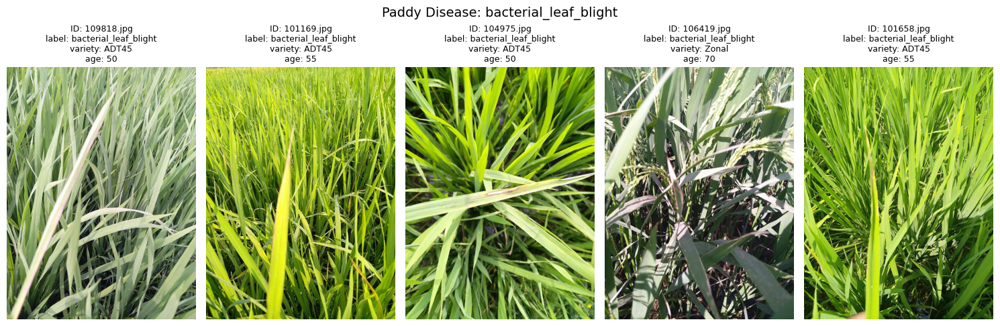

			+--------------------------------------------------------------------+
			|           VISUALIZING IMAGES FOR `BACTERIAL_LEAF_STREAK`           |
			+--------------------------------------------------------------------+


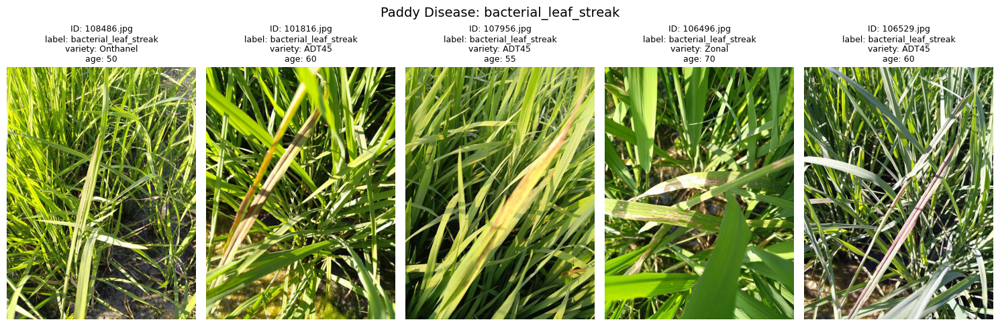

			+-----------------------------------------------------------------------+
			|           VISUALIZING IMAGES FOR `BACTERIAL_PANICLE_BLIGHT`           |
			+-----------------------------------------------------------------------+


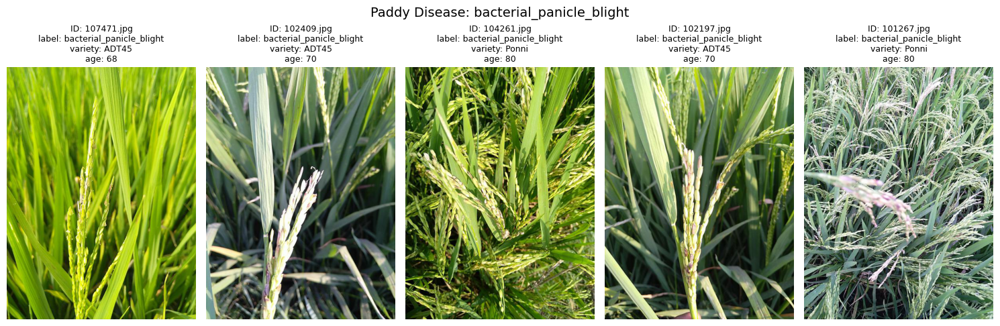

			+----------------------------------------------------+
			|           VISUALIZING IMAGES FOR `BLAST`           |
			+----------------------------------------------------+


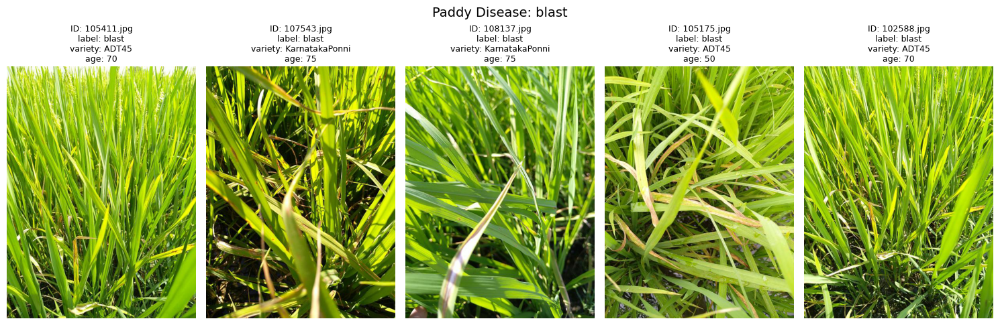

			+---------------------------------------------------------+
			|           VISUALIZING IMAGES FOR `BROWN_SPOT`           |
			+---------------------------------------------------------+


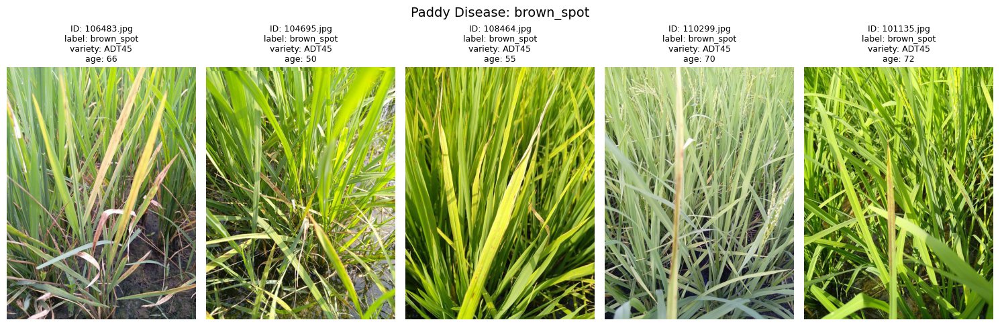

			+---------------------------------------------------------+
			|           VISUALIZING IMAGES FOR `DEAD_HEART`           |
			+---------------------------------------------------------+


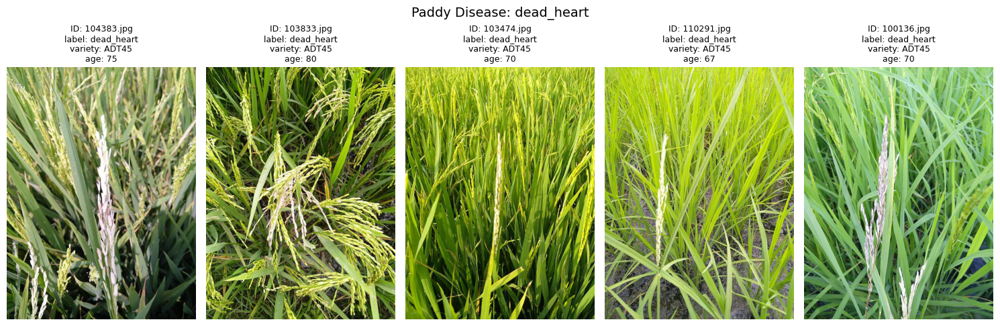

			+-----------------------------------------------------------+
			|           VISUALIZING IMAGES FOR `DOWNY_MILDEW`           |
			+-----------------------------------------------------------+


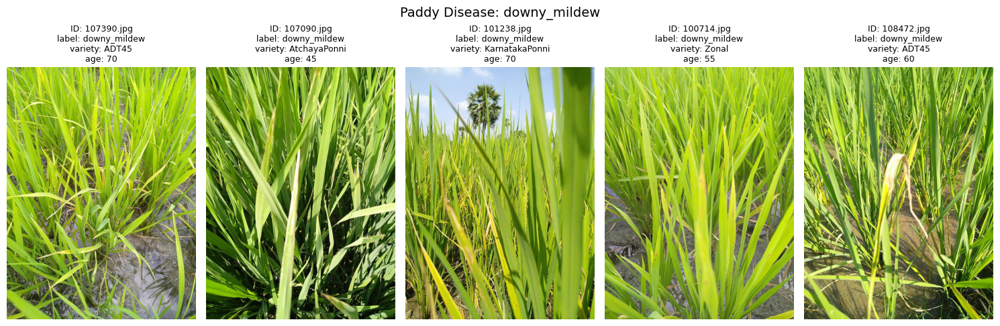

			+----------------------------------------------------+
			|           VISUALIZING IMAGES FOR `HISPA`           |
			+----------------------------------------------------+


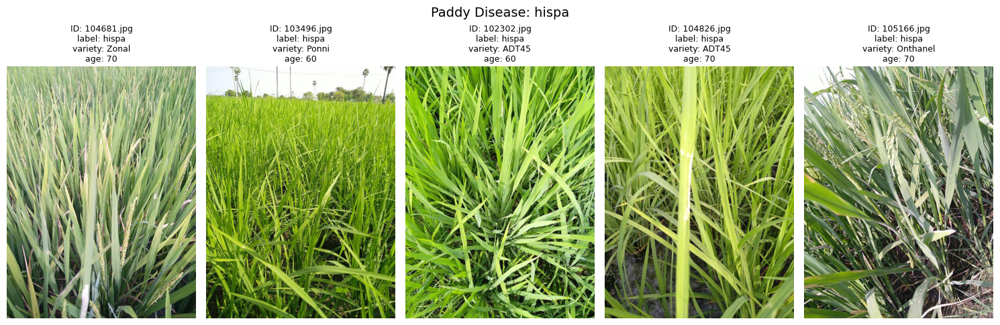

			+-----------------------------------------------------+
			|           VISUALIZING IMAGES FOR `NORMAL`           |
			+-----------------------------------------------------+


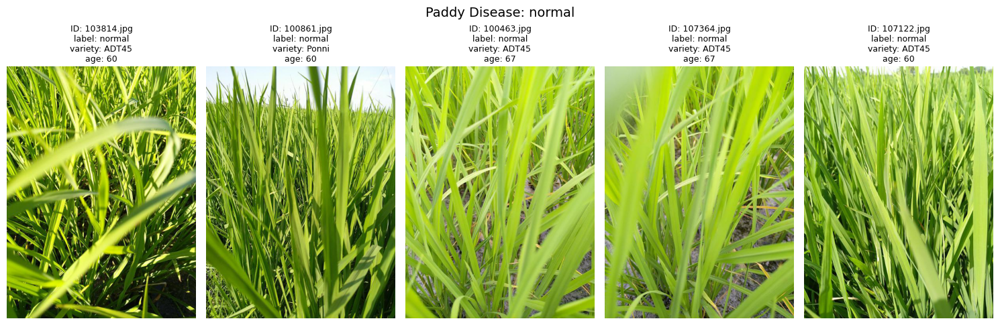

			+-----------------------------------------------------+
			|           VISUALIZING IMAGES FOR `TUNGRO`           |
			+-----------------------------------------------------+


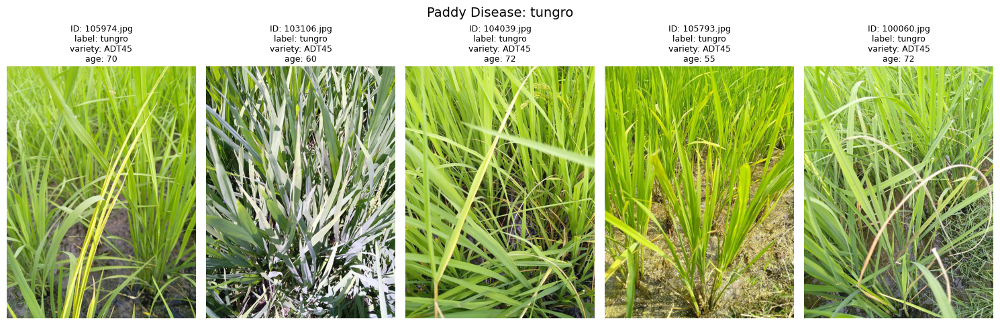

In [208]:
# List of directories for each label
labels = [
    "bacterial_leaf_blight",
    "bacterial_leaf_streak",
    "bacterial_panicle_blight",
    "blast",
    "brown_spot",
    "dead_heart",
    "downy_mildew",
    "hispa",
    "normal",
    "tungro",
]

# Base path for the image directories
base_path = "./inputs/train_images"

# Loop through each label directory and display images
for label in labels:
    # Filter dataframe for the current label
    label_df = clean_df[clean_df["label"] == label].sample(5, random_state=42)

    directory = os.path.join(base_path, label)
    print_header(f"Visualizing Images for `{label}`", tabs=True)

    # Display image
    visualize_images(
        label_df,
        num_images=len(label_df),
        title=f"Paddy Disease: {label}",
        figsize=(15, 5),
    )

### 4.2) Variety Image Visualization

Note: Tạo lại function cho gọn


			+----------------------------------------------------+
			|           VISUALIZING IMAGES FOR `ADT45`           |
			+----------------------------------------------------+


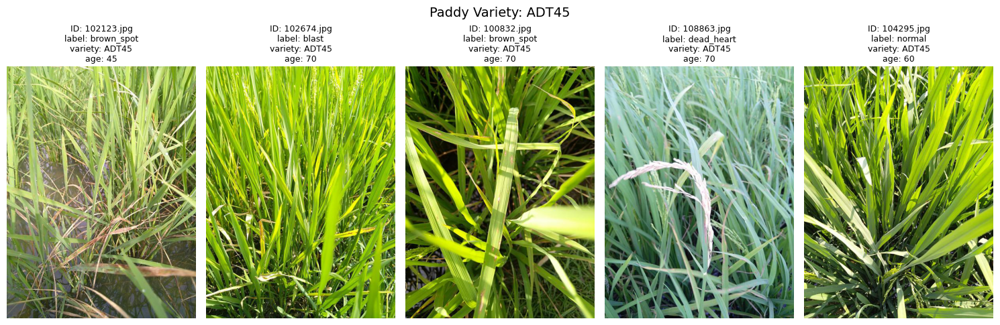

			+---------------------------------------------------+
			|           VISUALIZING IMAGES FOR `IR20`           |
			+---------------------------------------------------+


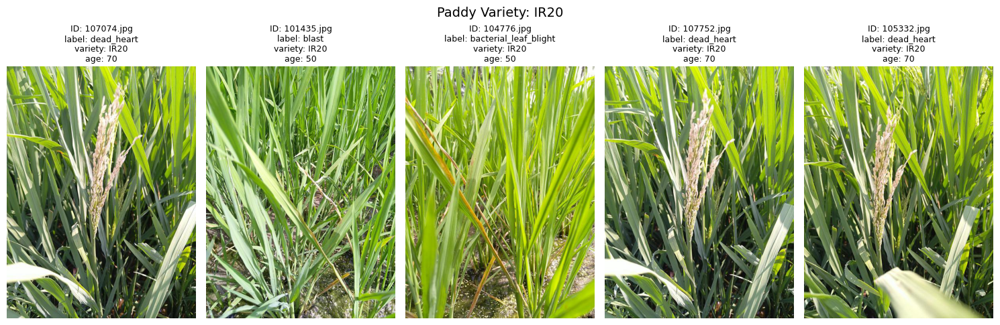

			+-------------------------------------------------------------+
			|           VISUALIZING IMAGES FOR `KARNATAKAPONNI`           |
			+-------------------------------------------------------------+


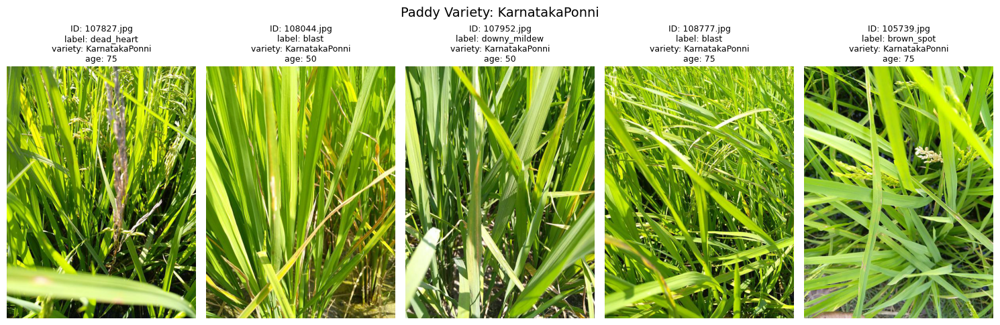

			+-------------------------------------------------------+
			|           VISUALIZING IMAGES FOR `ONTHANEL`           |
			+-------------------------------------------------------+


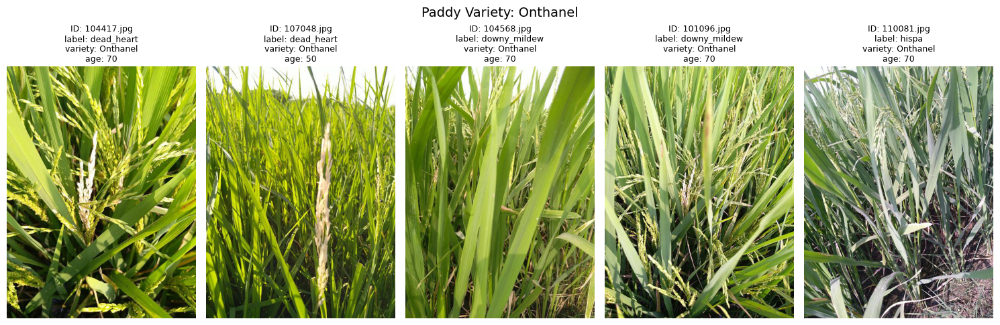

			+----------------------------------------------------+
			|           VISUALIZING IMAGES FOR `PONNI`           |
			+----------------------------------------------------+


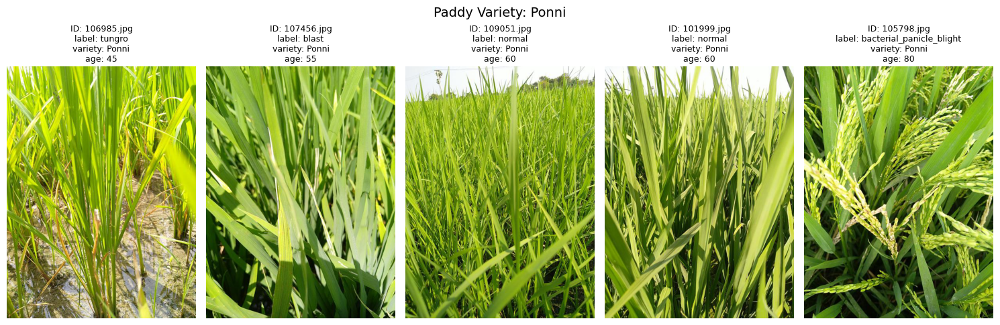

			+----------------------------------------------------+
			|           VISUALIZING IMAGES FOR `SURYA`           |
			+----------------------------------------------------+


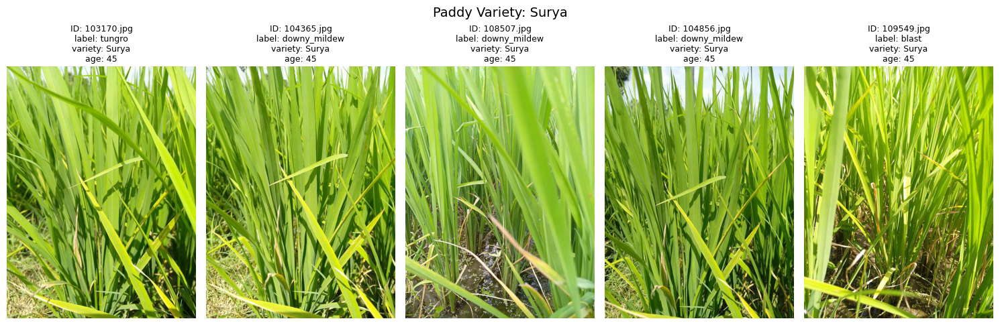

			+----------------------------------------------------+
			|           VISUALIZING IMAGES FOR `ZONAL`           |
			+----------------------------------------------------+


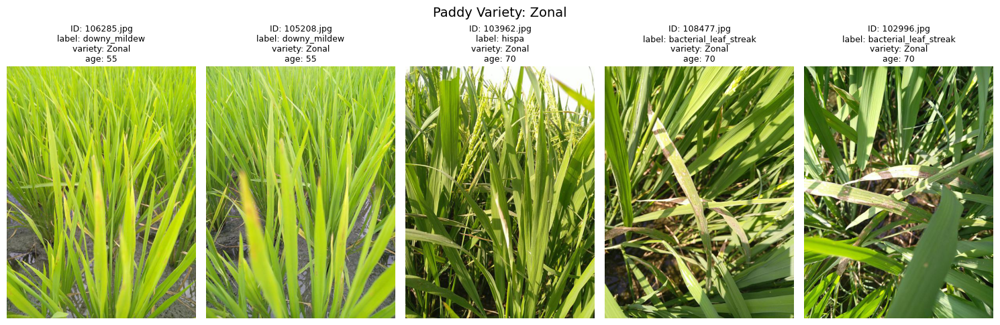

			+---------------------------------------------------------+
			|           VISUALIZING IMAGES FOR `ANDRAPONNI`           |
			+---------------------------------------------------------+


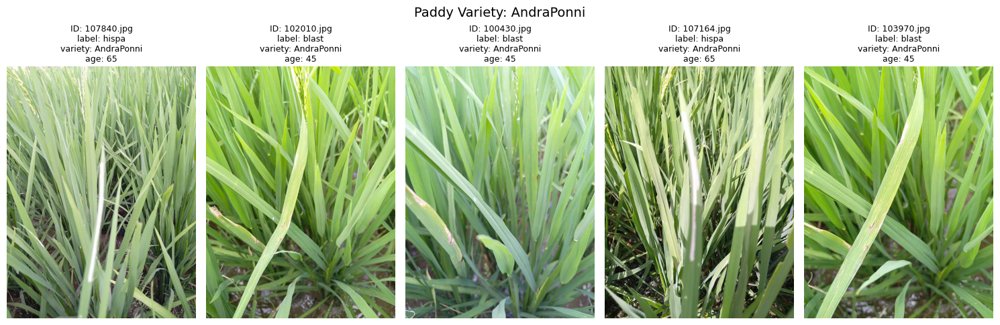

			+-----------------------------------------------------------+
			|           VISUALIZING IMAGES FOR `ATCHAYAPONNI`           |
			+-----------------------------------------------------------+


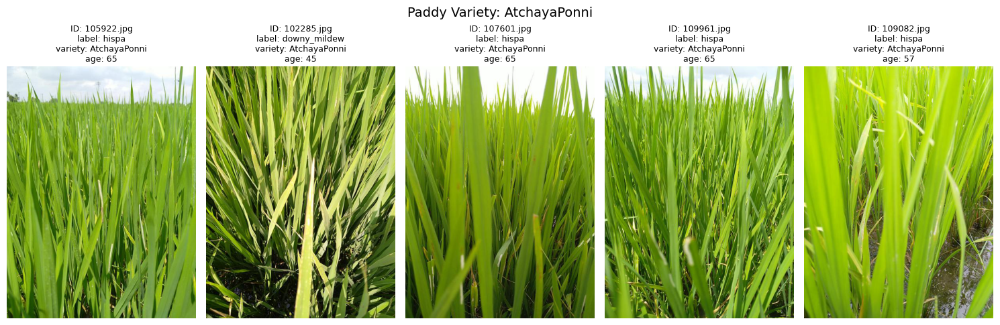

			+-------------------------------------------------+
			|           VISUALIZING IMAGES FOR `RR`           |
			+-------------------------------------------------+


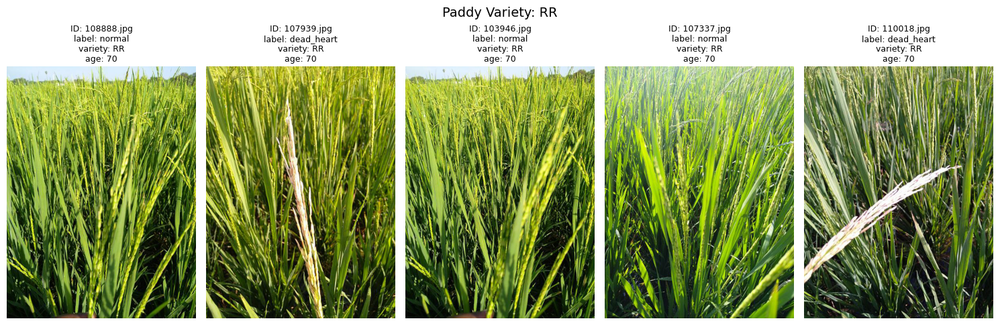

In [ ]:
# List of paddy varieties
varieties = clean_df["variety"].unique().tolist()

for variety in varieties:
    variety_df = clean_df[clean_df["variety"] == variety].sample(5, random_state=42)

    print_header(f"Visualizing Images for `{variety}`", tabs=True)

    visualize_images(
        variety_df,
        num_images=len(variety_df),
        title=f"Paddy Variety: {variety}",
        figsize=(15, 5),
    )

## 5) Distribution (rename later)

### 5.1) Plot label distribution

The label distribution of the paddy disease introduces a moderately imbalanced dataset with some classes significantly more represented than others:

- `normal` is most represented, which occupied approximately 17.0% of the samples.

- `blast` (16.7%), `hispa` (15.3%), and `dead_heart`(13.9%) are the three most popular diseases in the captured paddy.

- Conversely, `bacterial_panicle_bight` (3.3%) and `bacterial_leaf_steak` (3.6%) are the least common, indicating a potential challenge for further models to learn from these minority classes.

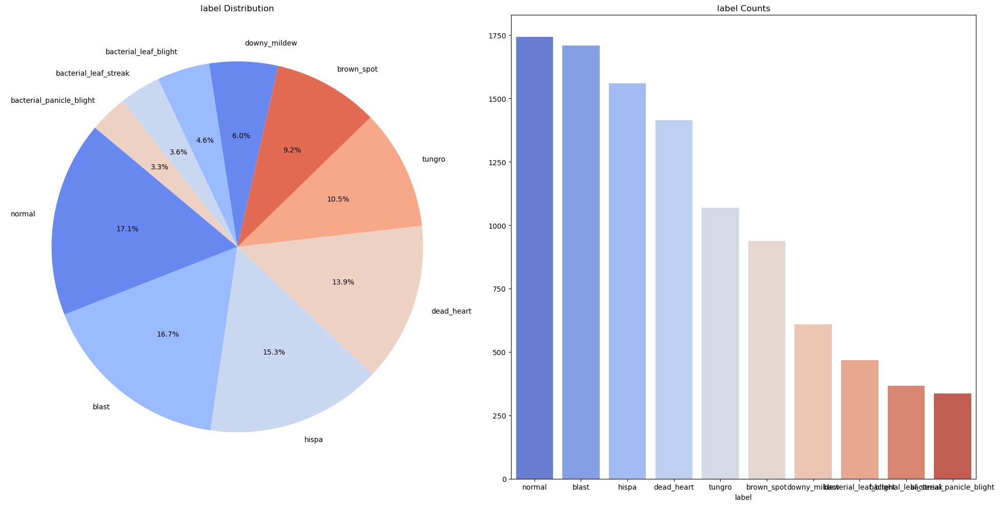

In [210]:
visualize_category_distribution(clean_df, 'label')

### 5.2) Plot Variety Distribution

The **variety distribution** shows the **highly** imbalanced, where `ADT45` is the dominant variety, accounting for more than half of the dataset at 67.3%. By contrast, `Surya` and `RR` occupied less than 1%. 

This significant dominance of a single variety (`ADT45`) is a huge challenge for model training, where the model will be biased toward this variety if there's no balancing technique applied.

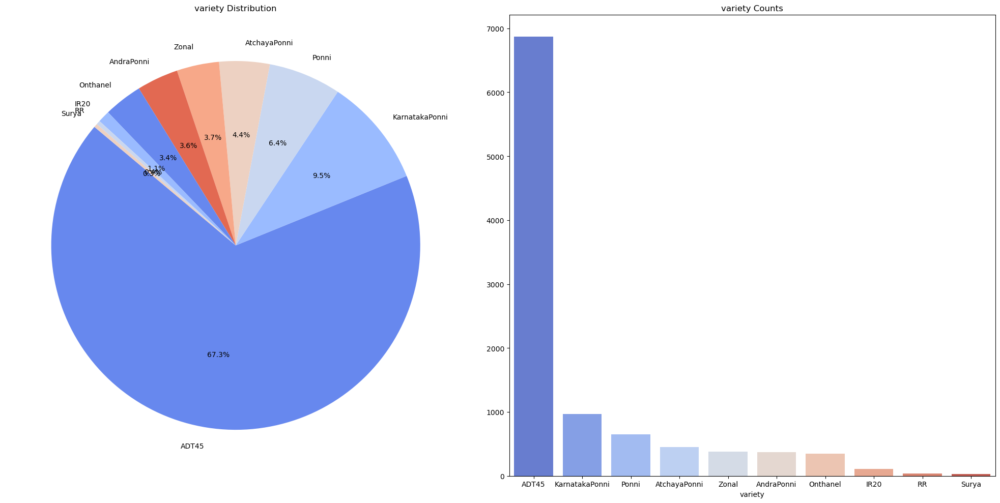

In [211]:
visualize_category_distribution(clean_df, 'variety')

### 5.3) Plot Age Distribution



The data distribution in the `age` column is slightly imbalanced:
- The most common age is `70` days which accounts for 29.6% of the dataset. `70` days is the average age of paddy plants in the reproductive phase, which is the most common growth stage for rice plants.
- The second most common age is `60` days which accounts for 16%
- The third most common age is `50` days which accounts for 10.2%
- The least common age is `62` days and `82` days accounting for less than 0.5%

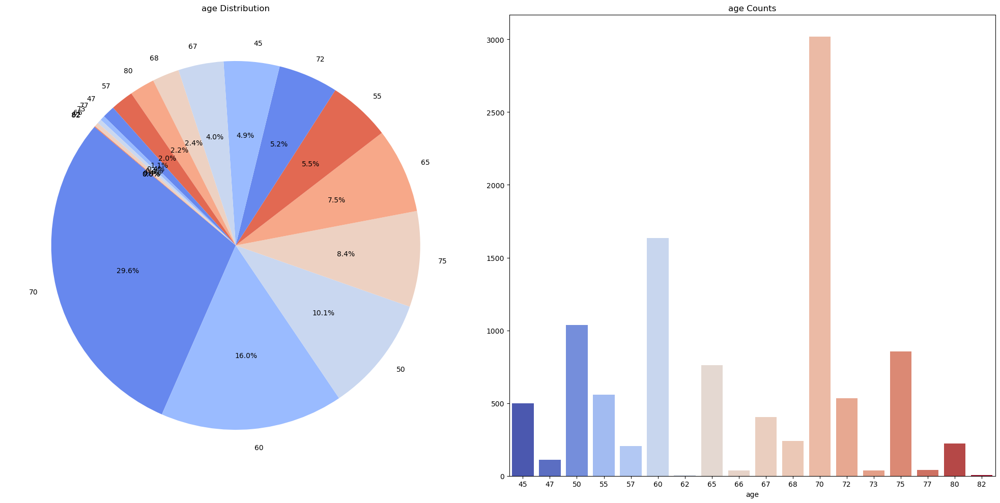

In [212]:
visualize_category_distribution(clean_df, 'age')

The age of each variety is quite approximately the same, with the exception of `Surya` which are younger than the other.
- `RR` is the variety with the biggest average age(around 70 days)
- `KarnatakaPonni` is the second biggest average age(around 69 days)
- `Zonal` is the third biggest average age(around 65 days)
- `Surya` is the variety with the smallest average age(around 45 days)

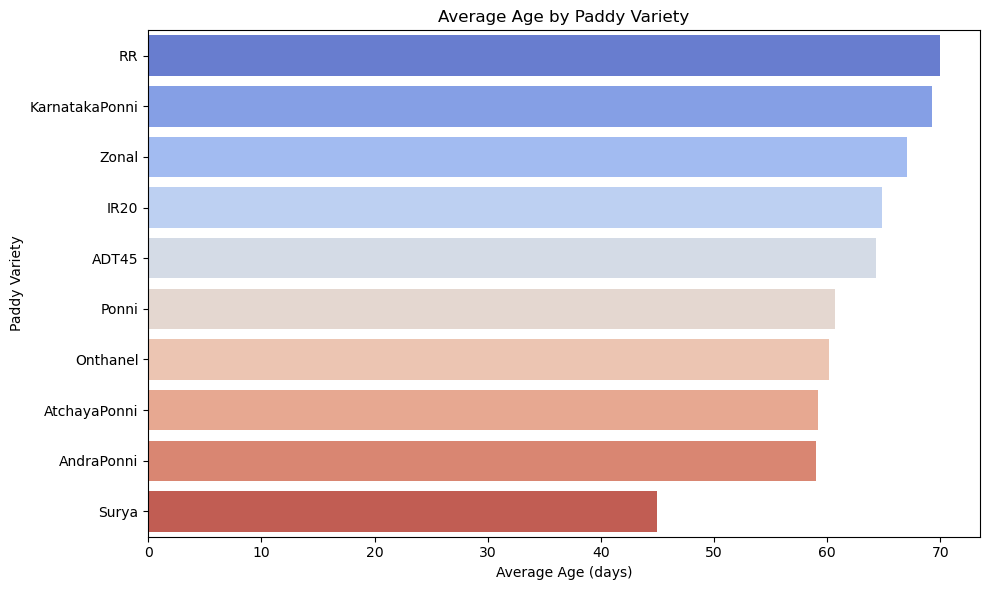

In [213]:
plot_grouped_bar(
    clean_df,
    group_col="variety",
    value_col="age",
    agg_func="mean",
    title="Average Age by Paddy Variety",
    x_label="Average Age (days)",
    y_label="Paddy Variety",
)

Gennerally, the majority of diseases appear in the range 60-70 days, which is the reproductive phase of paddy plants.
- `bacterial_leaf_blight` is the disease that appears latest which is around 70 days
- `dead_heart` and `brown_spot` are the diseases that appear second amd third latest which are 68 and 64 days respectively
- `downy_mildew` is the disease that appears earliest which is around 60 days

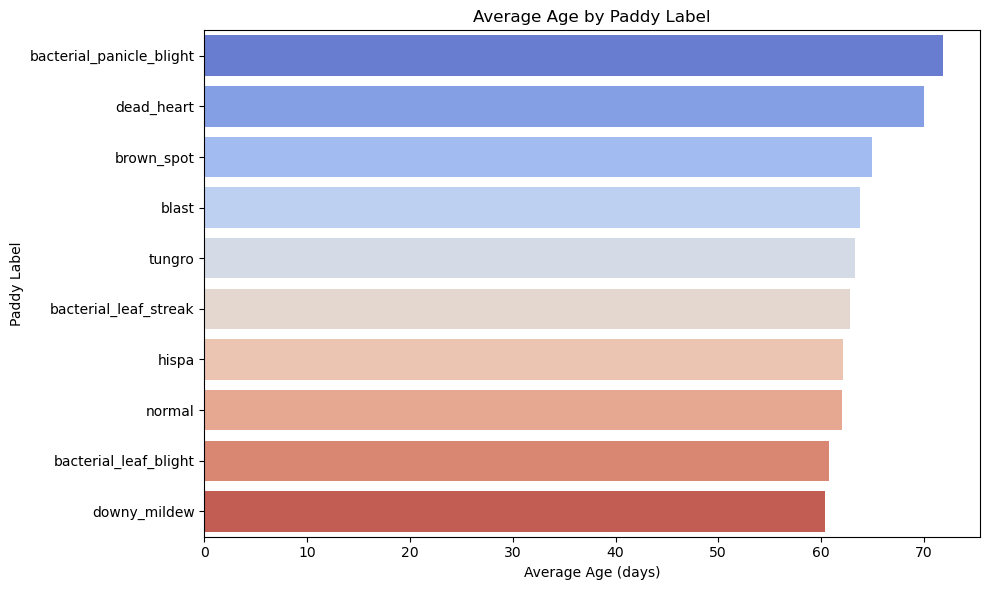

In [214]:
plot_grouped_bar(
    clean_df,
    group_col="label",
    value_col="age",
    agg_func="mean",
    title="Average Age by Paddy Label",
    x_label="Average Age (days)",
    y_label="Paddy Label",
)

### 5.4) Variety vs Label

Disease occurrence varies strongly by variety
- `ADT45` dominates the dataset with all types of labels, especially `normal`, `dead_heart`, `tungro`.
- `KarnatakaPonni` falls mainly into `blast` disease
- Other variety have sparse records. For instance, `RR`, and `Surya` have almost no disease record

(khúc này chưa para, khúc trên cũng nên cần para lại)
Specific diseases are concentrated in specific varieties

Diseases like tungro and hispa are heavily concentrated in ADT45.

Varieties like AndraPonni, AtchayaPonni, and Zonal have very few diseases overall.


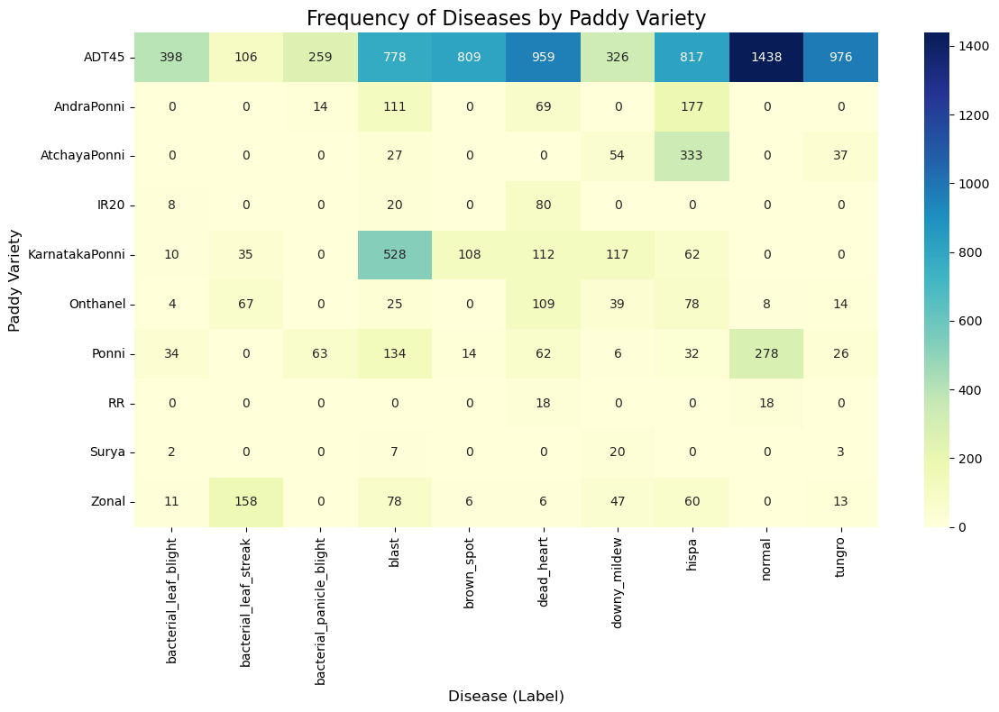

In [215]:
variety_label_counts = (
    clean_df.groupby(["variety", "label"]).size().unstack(fill_value=0)
)

# Plot the heatmap
plt.figure(figsize=(12, 8))
sns.heatmap(variety_label_counts, annot=True, fmt="d", cmap="YlGnBu", cbar=True)

# Add titles and labels
plt.title("Frequency of Diseases by Paddy Variety", fontsize=16)
plt.xlabel("Disease (Label)", fontsize=12)
plt.ylabel("Paddy Variety", fontsize=12)

# Show the plot
plt.tight_layout()
plt.show()

# IV. DATA PREPROCESSING

## 1) Helper Functions

In [75]:
def apply_img_cutout(image, percentage=0.2, rng=None):
    """
    Cut the image based on the percentage

    - image: the image to cut
    - percentage: the percentage of cutout
    - rng: Random number generator for reproducibility.

    """
    if rng is None:
        rng = np.random

    h, w = image.shape[:2]
    cutout_size_h = int(h * percentage)
    cutout_size_w = int(w * percentage)

    # Random position for cutout
    x = rng.randint(0, w - cutout_size_w)
    y = rng.randint(0, h - cutout_size_h)

    # Create copy of the image
    img_cutout = image.copy()
    img_cutout[y : y + cutout_size_h, x : x + cutout_size_w] = 0

    return img_cutout

In [77]:
def zoom_in_crop(image, zoom_factor=1.2):
    """
    Zoom in on the image by cropping the edges and resizing back to original size

    - image: the image file
    - zoom_factor: the zoom ratio
    """
    h, w = image.shape[:2]

    # Calculate crop dimensions
    crop_h = int(h / zoom_factor)
    crop_w = int(w / zoom_factor)

    # Calculate offsets to center the crop
    start_y = (h - crop_h) // 2
    start_x = (w - crop_w) // 2

    # Crop and resize
    cropped = image[start_y : start_y + crop_h, start_x : start_x + crop_w]
    zoomed = cv2.resize(cropped, (w, h), interpolation=cv2.INTER_LINEAR)

    return zoomed

In [78]:
def random_crop_resize(image, crop_percent=0.8, rng=None):
    """
    Random crop of the image followed by resize to original dimensions

    - image: input image
    - crop_percent: Percentage of the image to keep
    - rng  Random number generator for reproducibility.
    """
    if rng is None:
        rng = np.random

    h, w = image.shape[:2]
    crop_h = int(h * crop_percent)
    crop_w = int(w * crop_percent)

    # Random starting point for crop
    start_y = rng.randint(0, h - crop_h + 1)
    start_x = rng.randint(0, w - crop_w + 1)

    # Crop and resize
    cropped = image[start_y : start_y + crop_h, start_x : start_x + crop_w]
    resized = cv2.resize(cropped, (w, h), interpolation=cv2.INTER_LINEAR)

    return resized

In [79]:
def rotate_image(image, angle):
    """
    Rotates an image by the specified angle.

    Parameters:
    - image: Input image
    - angle: Array of angles in degrees

    Returns:
    - Rotated image with the same dimensions as input
    """
    # Get image dimensions and center
    height, width = image.shape[:2]
    center = (width // 2, height // 2)

    # Calculate rotation matrix
    rotation_matrix = cv2.getRotationMatrix2D(center, angle, 1.0)

    # Apply rotation while maintaining original dimensions
    rotated = cv2.warpAffine(
        image,
        rotation_matrix,
        (width, height),
        flags=cv2.INTER_LINEAR,
        borderMode=cv2.BORDER_REFLECT,  # Avoid black borders
    )

    return rotated

In [80]:
def df_augmentation(
    df,
    output_csv_path="./inputs/meta_train_augmented.csv",
    img_augmented_dir="./inputs/train_augmented_images",
    random_state=42,
):
    """
    Augments underrepresented paddy varieties using various image transformations.

    Parameters:
    - df: Original dataFrame containing image metadata
    - output_csv_path: Path to save the augmented metadata CSV
    - img_original_dir: Directory containing original images
    - img_augmented_dir: Directory to save augmented images
    - random_state: Seed for reproducible augmentations

    Returns:
    - augmented_df: DataFrame containing original and augmented image metadata
    - augmented_count: Dictionary counting new images per variety
    """
    # Fixed seed RNG for consistent augmentations
    rng = np.random.RandomState(random_state)

    # ensure that the img_augmented_dir exists
    os.makedirs(img_augmented_dir, exist_ok=True)

    target_varieties = df["variety"].value_counts()

    # Create new rows for augmented images
    new_rows = []
    augmented_count = defaultdict(int)

    # Define augmentation strategies based on variety count
    VERY_LOW_COUNT = 50
    LOW_COUNT = 110
    MID_LOW_COUNT = 400
    MID_COUNT = 800
    HIGH_COUNT = 1000

    for _, row in tqdm(df.iterrows(), total=len(df), desc="Generating augmentations"):
        image_id, label, variety, age = (
            row["image_id"],
            row["label"],
            row["variety"],
            row["age"],
        )

        # Get image path
        image_path = row["image_path"]

        variety_count = target_varieties[variety]

        # if the current variety count exceeds the HIGH_COUNT already -> skip
        if variety_count >= HIGH_COUNT:
            continue

        # if the path doesn't exist
        if not os.path.exists(image_path):
            print(f"[ERROR] Invalid image path: {image_path}")
            continue

        image = cv2.imread(image_path)

        if image is None:
            print(f"[ERROR] Failed to load image: {image_path}")
            continue

        augmentations = []

        # For very low count (<=50)
        if variety_count < VERY_LOW_COUNT:
            # Rotations augmentations
            for angle in [-15, -10, -5, 5, 10, 15]:
                rotated = rotate_image(image, angle)
                augmentations.append((f"rot_{angle}", rotated))

            # Horizontal flip
            augmentations.append(("hflip", cv2.flip(image, 1)))

            # Vertical flip
            augmentations.append(("vflip", cv2.flip(image, 0)))

            # Brightness adjustment positive_20 and negative_20(+20% and -20%)
            augmentations.append(
                ("bright_p20", cv2.convertScaleAbs(image, alpha=1.2, beta=0))
            )
            augmentations.append(
                ("bright_n20", cv2.convertScaleAbs(image, alpha=0.8, beta=0))
            )

            # Zoom-in crop
            augmentations.append(("zoom", zoom_in_crop(image)))

            # Cutout
            augmentations.append(("cutout", apply_img_cutout(image, rng=rng)))

        # Low count variety (< 100)
        elif variety_count < LOW_COUNT:
            # Apply rotations
            for angle in [-10, -5, 5, 10]:
                rotated = rotate_image(image, angle)
                augmentations.append((f"rot_{angle}", rotated))

            # Brightness adjustments (+20% and -20%)
            augmentations.append(
                ("bright_p20", cv2.convertScaleAbs(image, alpha=1.2, beta=0))
            )
            augmentations.append(
                ("bright_n20", cv2.convertScaleAbs(image, alpha=0.8, beta=0))
            )

        # Lower than 400
        elif variety_count < MID_LOW_COUNT:
            # Limited rotations
            for angle in [-5, 5]:
                rotated = rotate_image(image, angle)
                augmentations.append((f"rot_{angle}", rotated))

            # Random crop and resize
            augmentations.append(("crop_resize", random_crop_resize(image, rng=rng)))

        # Lower than 650 counts
        elif variety_count < MID_COUNT:
            for angle in [-5, 5]:
                rotated = rotate_image(image, angle)
                augmentations.append((f"rot_{angle}", rotated))

        # Apply all selected augmentations
        for aug_name, aug_img in augmentations:
            # Extract base name without extension
            base_name = os.path.splitext(image_id)[0]

            new_image_id = f"{base_name}_{aug_name}.jpg"

            label_dir = os.path.join(img_augmented_dir, label)
            os.makedirs(label_dir, exist_ok=True)

            new_path = os.path.join(label_dir, f"{new_image_id}")

            # If the image file doesn't exist
            if not os.path.exists(new_path):
                cv2.imwrite(new_path, aug_img)

            new_rows.append(
                {
                    "image_id": new_image_id,
                    "label": label,
                    "variety": variety,
                    "age": age,
                    "image_path": new_path,
                }
            )
            augmented_count[variety] += 1

    # Create augmented DataFrame
    augmented_df = pd.concat([df, pd.DataFrame(new_rows)], ignore_index=True)

    # Save augmented metadata
    augmented_df.to_csv(output_csv_path, index=False)

    print_header("Augmentation Summary")
    print(f"Original dataset: {len(df)} images")
    print(f"Augmented dataset: {len(augmented_df)} images")
    print(f"Added {len(new_rows)} augmented images")

    return augmented_df, augmented_count

In [81]:
def display_augmentation_examples(
    original_df,
    augmented_df,
    tiers,
    augmentations,
):
    """
    Display examples of each type of augmentation applied to images from different variety tiers

    Parameters:
    - original_df: original DataFrame metadata
    - augmented_df: augmented DataFrame metadata
    - tiers: Dictionary mapping tier names to lists of variety names belonging to that tier
    - augmentations: Dictionary mapping tier names to lists of augmentation types applied to that tier
    """
    for tier_name, varieties in tiers.items():
        if not varieties:
            continue

        # Take the first variety in this tier
        variety = varieties[0]

        # Find an example image for this variety
        sample_row = original_df[original_df["variety"] == variety].iloc[0]
        original_image_id = sample_row["image_id"]
        original_path = sample_row["image_path"]
        base_name = os.path.splitext(original_image_id)[0]

        print_header(f"Augmentation Examples for {tier_name} Tier - Variety: {variety}")

        # For each augmentation type applied to this tier
        aug_types = augmentations[tier_name]
        num_augs = len(aug_types)

        # Create a figure with 1 row for original + augmentations
        fig, axes = plt.subplots(
            1, num_augs + 1, figsize=(3 * (num_augs + 1), 4), facecolor="white"
        )

        # Display original image first
        try:
            original_img = mpimg.imread(original_path)
            axes[0].imshow(original_img)
            axes[0].set_title(f"Original", fontsize=10)
            axes[0].axis("off")
        except FileNotFoundError:
            axes[0].text(0.5, 0.5, "Image not found", ha="center", va="center")
            axes[0].axis("off")

        # Display each augmentation type
        for i, aug_type in enumerate(aug_types):
            aug_image_id = f"{base_name}_{aug_type}.jpg"

            aug_row = augmented_df[augmented_df["image_id"] == aug_image_id]

            aug_path = aug_row.iloc[0]["image_path"]

            try:
                aug_img = mpimg.imread(aug_path)
                axes[i + 1].imshow(aug_img)
                axes[i + 1].set_title(f"{aug_type}", fontsize=10)
                axes[i + 1].axis("off")
            except FileNotFoundError:
                axes[i + 1].text(
                    0.5, 0.5, "Augmented image\nnot found", ha="center", va="center"
                )
                axes[i + 1].axis("off")

        plt.suptitle(
            f"{tier_name} Tier ({variety}): Original vs Augmentations", fontsize=16
        )
        plt.tight_layout()
        plt.subplots_adjust(top=0.85)
        plt.show()

## 2) Split the dataset

any apply any preprocessing dataset, we need to split it into training and validation set to avoid data leaked

In [82]:
# Define random_state
random_state = 42

train_df, val_df = train_test_split(clean_df, test_size=0.2, random_state=random_state)

print_header("Train Dataset shape")
print("Number of Rows: ", train_df.shape[0])
print("Number of Columns: ", train_df.shape[1])

print_header("Validation Dataset Shape")
print("Number of Rows: ", val_df.shape[0])
print("Number of Columns: ", val_df.shape[1])

+-----------------------------------------+
|           TRAIN DATASET SHAPE           |
+-----------------------------------------+
Number of Rows:  8166
Number of Columns:  5
+----------------------------------------------+
|           VALIDATION DATASET SHAPE           |
+----------------------------------------------+
Number of Rows:  2042
Number of Columns:  5


## 3) Handle imbalance dataset

Currently we see that, khúc này viết là những variety nào dưới 1000 thì mình sẽ nhân lên để cho cái class nó balanced hơn.

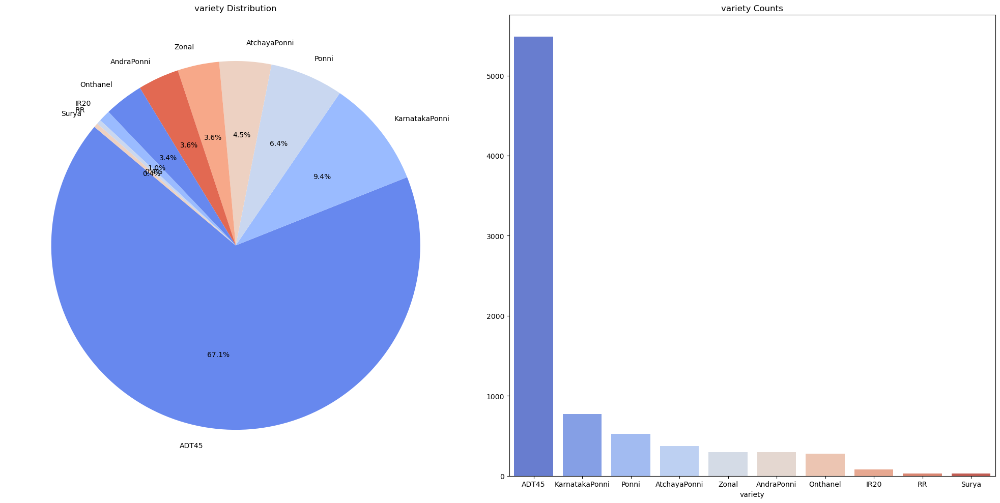

In [83]:
visualize_category_distribution(train_df, "variety")

In [85]:
augmented_df, augmented_count = df_augmentation(train_df)

Generating augmentations: 100%|██████████| 8166/8166 [00:07<00:00, 1078.54it/s]

+------------------------------------------+
|           AUGMENTATION SUMMARY           |
+------------------------------------------+
Original dataset: 8166 images
Augmented dataset: 15727 images
Added 7561 augmented images


In [86]:
print_header("Augmentation Summary for Varieties:")
for variety, count in sorted(augmented_count.items(), key=lambda x: x[1], reverse=True):
    original_count = train_df[train_df["variety"] == variety].shape[0]
    new_count = original_count + count
    print(f"- {variety}: +{count} new images (now {new_count} total)")

+---------------------------------------------------------+
|           AUGMENTATION SUMMARY FOR VARIETIES:           |
+---------------------------------------------------------+
- KarnatakaPonni: +1540 new images (now 2310 total)
- AtchayaPonni: +1113 new images (now 1484 total)
- Ponni: +1050 new images (now 1575 total)
- Zonal: +894 new images (now 1192 total)
- AndraPonni: +885 new images (now 1180 total)
- Onthanel: +837 new images (now 1116 total)
- IR20: +498 new images (now 581 total)
- RR: +384 new images (now 416 total)
- Surya: +360 new images (now 390 total)


In [87]:
augmented_df = pd.read_csv("inputs/meta_train_augmented.csv")

augmented_df

,image_id,label,variety,age,image_path
0,101224.jpg,brown_spot,Ponni,67,./inputs/train_images/brown_spot/101224.jpg
1,106118.jpg,hispa,ADT45,70,./inputs/train_images/hispa/106118.jpg
2,107833.jpg,dead_heart,KarnatakaPonni,75,./inputs/train_images/dead_heart/107833.jpg
3,109488.jpg,hispa,ADT45,45,./inputs/train_images/hispa/109488.jpg
4,109425.jpg,tungro,ADT45,60,./inputs/train_images/tungro/109425.jpg
...,...,...,...,...,...
15722,108250_rot_-5.jpg,dead_heart,Ponni,80,./inputs/train_augmented_images/dead_heart/108...
15723,108250_rot_5.jpg,dead_heart,Ponni,80,./inputs/train_augmented_images/dead_heart/108...
15724,106109_rot_-5.jpg,hispa,Onthanel,70,./inputs/train_augmented_images/hispa/106109_r...
15725,106109_rot_5.jpg,hispa,Onthanel,70,./inputs/train_augmented_images/hispa/106109_r...


In [88]:
augmented_df["variety"].value_counts()

variety
ADT45             5483
KarnatakaPonni    2310
Ponni             1575
AtchayaPonni      1484
Zonal             1192
AndraPonni        1180
Onthanel          1116
IR20               581
RR                 416
Surya              390
Name: count, dtype: int64

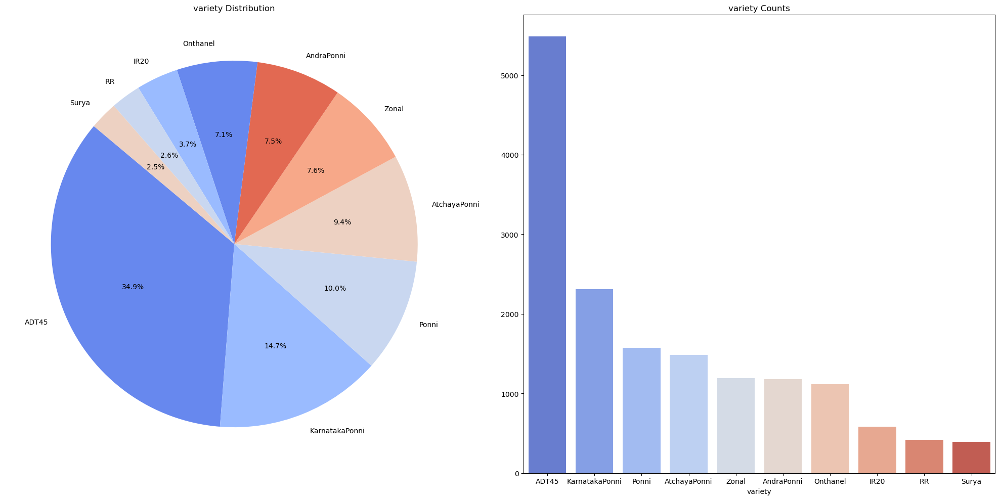

In [89]:
visualize_category_distribution(augmented_df, "variety")

+------------------------------------------------------------------------------------+
|           AUGMENTATION EXAMPLES FOR VERY LOW (<50) TIER - VARIETY: SURYA           |
+------------------------------------------------------------------------------------+


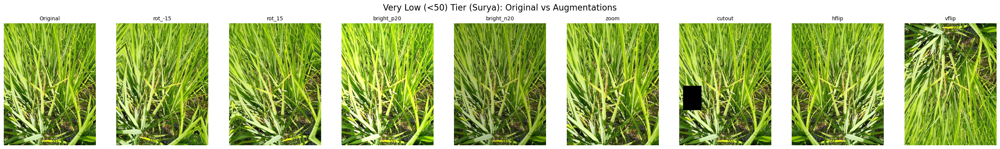

+---------------------------------------------------------------------------------+
|           AUGMENTATION EXAMPLES FOR LOW (50-110) TIER - VARIETY: IR20           |
+---------------------------------------------------------------------------------+


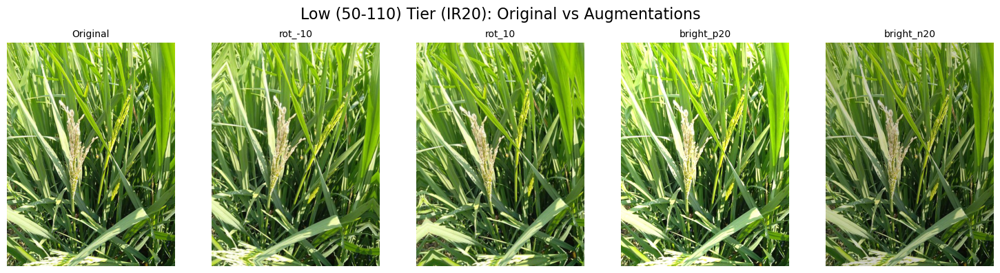

+------------------------------------------------------------------------------------------+
|           AUGMENTATION EXAMPLES FOR MID-LOW (110-400) TIER - VARIETY: ONTHANEL           |
+------------------------------------------------------------------------------------------+


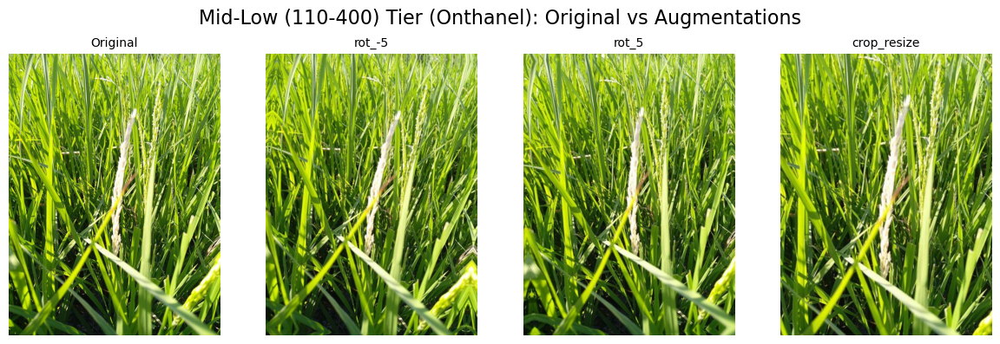

+------------------------------------------------------------------------------------------+
|           AUGMENTATION EXAMPLES FOR MID (400-800) TIER - VARIETY: ATCHAYAPONNI           |
+------------------------------------------------------------------------------------------+


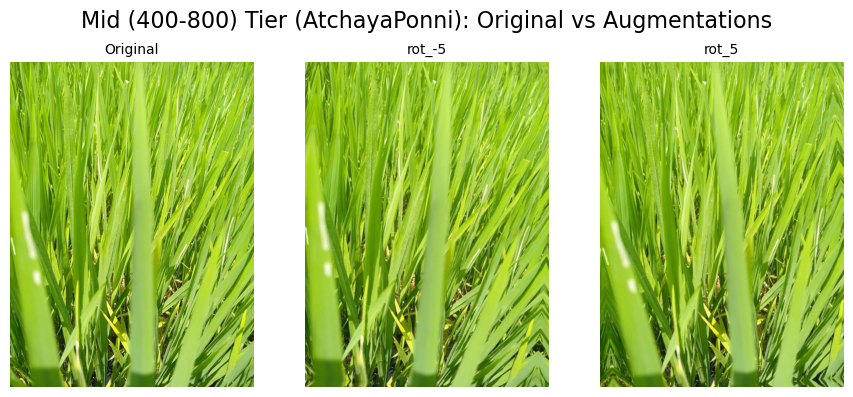

In [90]:
tiers = {
    "Very Low (<50)": ["Surya", "RR"],
    "Low (50-110)": ["IR20"],
    "Mid-Low (110-400)": ["Onthanel", "AndraPonni", "Zonal"],
    "Mid (400-800)": ["AtchayaPonni", "Ponni"],
}

augmentations = {
    "Very Low (<50)": [
        "rot_-15",
        "rot_15",
        "bright_p20",
        "bright_n20",
        "zoom",
        "cutout",
        "hflip",
        "vflip",
    ],
    "Low (50-110)": ["rot_-10", "rot_10", "bright_p20", "bright_n20"],
    "Mid-Low (110-400)": ["rot_-5", "rot_5", "crop_resize"],
    "Mid (400-800)": ["rot_-5", "rot_5"],
}
display_augmentation_examples(train_df, augmented_df, tiers, augmentations)

After the augmenting, mọi thứ đều ổn hơn như ADT chỉ còn 40%. nhưng mà có một số variety vẫn thấp hơn 1000 samples, ví dụ như Ponni, IR20, RR và Surya, điều này khiến model không thể nào nhận biết được  giống này khi mình train với số lượng quá ít.

In [67]:
print_header("The total number of each variety after augmenting")
augmented_df["variety"].value_counts()

+-----------------------------------------------------------------------+
|           THE TOTAL NUMBER OF EACH VARIETY AFTER AUGMENTING           |
+-----------------------------------------------------------------------+


variety
ADT45             5483
KarnatakaPonni    2310
Ponni             1575
AtchayaPonni      1484
Zonal             1192
AndraPonni        1180
Onthanel          1116
IR20               581
RR                 416
Surya              390
Name: count, dtype: int64

THIẾU IN RA NHỮNG TẤM MỚI SỬA

In [ ]:
# print_header("Undersampling ADT45")

# # Choose `phash` for image hashing
# hash_fn = imagehash.phash
# threshold = 6
# target_cnt = 2000
# selected_img_ids = []
# used_hashes = []

# adt45_df = clean_df[clean_df["variety"] == "ADT45"]
# adt45_hash_dict = defaultdict(list)

# print(f"\nVariety ADT45 count: {len(adt45_df)}")

# for idx, row in tqdm(
#     adt45_df.iterrows(), total=len(adt45_df), desc="Hashing ADT45 variety"
# ):
#     img_path = row["image_path"]

#     if not os.path.exists(img_path):
#         print(f"[ERROR] {img_path} does not exist.")
#         continue

#     try:
#         img = Image.open(img_path).convert("RGB")
#         # Calculate hash and convert to string
#         img_hash = hash_fn(img)
#         adt45_hash_dict[row["image_id"]] = img_hash

#     except Exception as e:
#         print(f"[ERROR] {img_path}: {e}")

# for image_id, h in adt45_hash_dict.items():
#     is_diverse = all(h - uh > threshold for uh in used_hashes)

#     if is_diverse:
#         selected_img_ids.append(image_id)
#         used_hashes.append(h)

#     if len(selected_img_ids) >= target_cnt:
#         break

# print(f"\nSelected {len(selected_img_ids)} diverse ADT45 samples.")

# adt45_diverse_df = adt45_df[adt45_df["image_id"].isin(selected_img_ids)]

# # Combine with non-ADT45 varieties
# non_adt45_df = clean_df[clean_df["variety"] != "ADT45"]
# final_balanced_df = pd.concat([non_adt45_df, adt45_diverse_df]).reset_index(drop=True)

# print(f"\nFinal dataset shape: {final_balanced_df.shape}")

+-----------------------------------------+
|           UNDERSAMPLING ADT45           |
+-----------------------------------------+

Variety ADT45 count: 6866


Hashing ADT45 variety: 100%|██████████| 6866/6866 [00:25<00:00, 266.96it/s]



Selected 500 diverse ADT45 samples.

Final dataset shape: (3842, 5)
